## Libraries import + matplotlib preset


In [1]:
import os
import re   
import numpy as np
import pandas as pd

%matplotlib inline
import matplotlib.pyplot as plt
# pixel in inches for figsize
px = 1/plt.rcParams['figure.dpi']
# default figsize for all figures
plt.rcParams['figure.figsize'] = [800*px, 600*px]

## Crate paths for csv files


In [2]:
CURR_DIR = os.getcwd()
print(CURR_DIR)
data_path = os.path.join(CURR_DIR, 'datasets/Sleeve-material-loss-improved.csv')

/Users/wszczawinski/Projects/BearingMeasurementAnalysis/analyses


## Create dataframe from .cvs


In [3]:
df = pd.read_csv(data_path, sep=';', decimal=',')

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 278861 entries, 0 to 278860
Data columns (total 11 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   Number In Batch  274892 non-null  float64
 1   Count            274892 non-null  float64
 2   Time (ms)        274892 non-null  float64
 3   Timestamp        274892 non-null  object 
 4   Trigger          274892 non-null  object 
 5   obl X            274892 non-null  object 
 6   obl Y            274892 non-null  object 
 7   Odczyt Z         274892 non-null  float64
 8   Odczyt otwor     274892 non-null  object 
 9   Odczyt wal       274892 non-null  float64
 10  Kat obrotu       274892 non-null  float64
dtypes: float64(6), object(5)
memory usage: 23.4+ MB


## Dropping not relevant columns


In [4]:
df = df.drop(['Number In Batch', 'Time (ms)', 'Timestamp', 'Trigger'], axis = 1)

df


,Count,obl X,obl Y,Odczyt Z,Odczyt otwor,Odczyt wal,Kat obrotu
0,1.0,"1,0457",0,0.0,"1,0457",0.9362,0.0
1,2.0,"1,0458",0,0.0,"1,0458",0.9362,0.0
2,3.0,"1,0458",0,0.0,"1,0458",0.9362,0.0
3,4.0,"1,0457",0,0.0,"1,0458",0.9362,0.0
4,5.0,"1,0457",0,0.0,"1,0458",0.9362,0.0
...,...,...,...,...,...,...,...
278856,NaN,NaN,NaN,NaN,NaN,NaN,NaN
278857,NaN,NaN,NaN,NaN,NaN,NaN,NaN
278858,NaN,NaN,NaN,NaN,NaN,NaN,NaN
278859,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Removing rows with measurments over and under range of the sensor


In [5]:
for col in ['obl X', 'obl Y']:
    df = df[df[col].str.contains("Over Range")==False]
    df = df[df[col].str.contains("Under Range")==False]
    df[col] = pd.to_numeric(df[col].apply(lambda x: re.sub(',', '.', str(x))))

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 223064 entries, 0 to 274891
Data columns (total 7 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Count         223064 non-null  float64
 1   obl X         223064 non-null  float64
 2   obl Y         223064 non-null  float64
 3   Odczyt Z      223064 non-null  float64
 4   Odczyt otwor  223064 non-null  object 
 5   Odczyt wal    223064 non-null  float64
 6   Kat obrotu    223064 non-null  float64
dtypes: float64(6), object(1)
memory usage: 13.6+ MB


## Data exploration


In [6]:
df.head(900)

,Count,obl X,obl Y,Odczyt Z,Odczyt otwor,Odczyt wal,Kat obrotu
0,1.0,1.0457,0.0000,0.000,"1,0457",0.9362,0.00
1,2.0,1.0458,0.0000,0.000,"1,0458",0.9362,0.00
2,3.0,1.0458,0.0000,0.000,"1,0458",0.9362,0.00
3,4.0,1.0457,0.0000,0.000,"1,0458",0.9362,0.00
4,5.0,1.0457,0.0000,0.000,"1,0458",0.9362,0.00
...,...,...,...,...,...,...,...
1066,1067.0,0.8665,-0.1140,0.084,"0,874",0.9341,352.51
1067,1068.0,0.8664,-0.1139,0.084,"0,8739",0.9342,352.51
1068,1069.0,0.8664,-0.1139,0.084,"0,8739",0.9342,352.51
1069,1070.0,0.8657,-0.1138,0.084,"0,8731",0.9342,352.51


In [7]:
df.describe()

,Count,obl X,obl Y,Odczyt Z,Odczyt wal,Kat obrotu
count,223064.000000,223064.000000,223064.000000,223064.000000,223064.000000,223064.000000
mean,137200.896097,0.044143,-0.056859,20.672847,1.001642,156.826422
std,79314.101061,0.655581,0.703147,12.033807,0.031445,103.625744
min,1.000000,-0.991500,-1.077500,0.000000,0.918600,0.000000
25%,68497.750000,-0.555500,-0.810200,10.294000,0.976400,62.140000
50%,137020.500000,0.061300,0.035900,20.690000,0.997800,140.980000
75%,205937.250000,0.655600,0.682400,31.154000,1.030000,249.700000
max,274892.000000,1.049300,0.847000,41.552000,1.065800,352.620000


In [8]:
df.corr()

,Count,obl X,obl Y,Odczyt Z,Odczyt wal,Kat obrotu
Count,1.000000,-0.001015,0.002682,0.999993,0.201070,0.003723
obl X,-0.001015,1.000000,0.126798,-0.000822,-0.804636,-0.348340
obl Y,0.002682,0.126798,1.000000,0.002693,0.337854,-0.808962
Odczyt Z,0.999993,-0.000822,0.002693,1.000000,0.200779,0.003716
Odczyt wal,0.201070,-0.804636,0.337854,0.200779,1.000000,-0.054956
Kat obrotu,0.003723,-0.348340,-0.808962,0.003716,-0.054956,1.000000


### Single arrays from columns for ploting purposes


In [9]:
x = df['obl X']
y = df['obl Y']
z = df['Odczyt Z']
hole = df['Odczyt otwor']
shaft = df['Odczyt wal']
angle = df['Kat obrotu']
count = df['Count']

### Correlation between X and angle


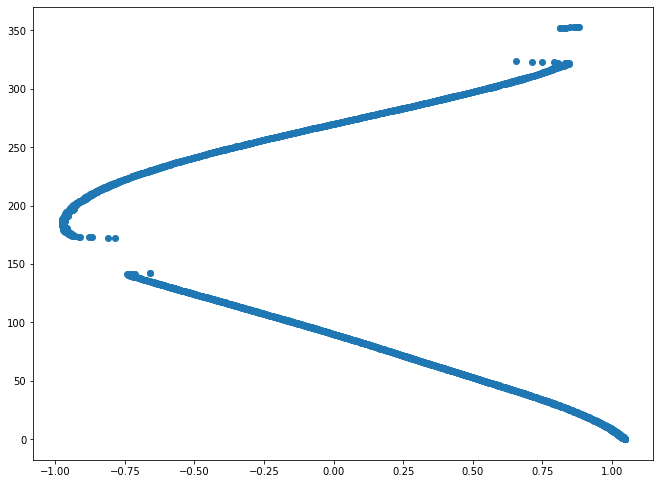

In [10]:
angles = angle[:2000]
xs = x[:2000]
plt.scatter(xs, angles)
plt.show()

array([[<AxesSubplot:title={'center':'Count'}>,
        <AxesSubplot:title={'center':'obl X'}>],
       [<AxesSubplot:title={'center':'obl Y'}>,
        <AxesSubplot:title={'center':'Odczyt Z'}>],
       [<AxesSubplot:title={'center':'Odczyt wal'}>,
        <AxesSubplot:title={'center':'Kat obrotu'}>]], dtype=object)

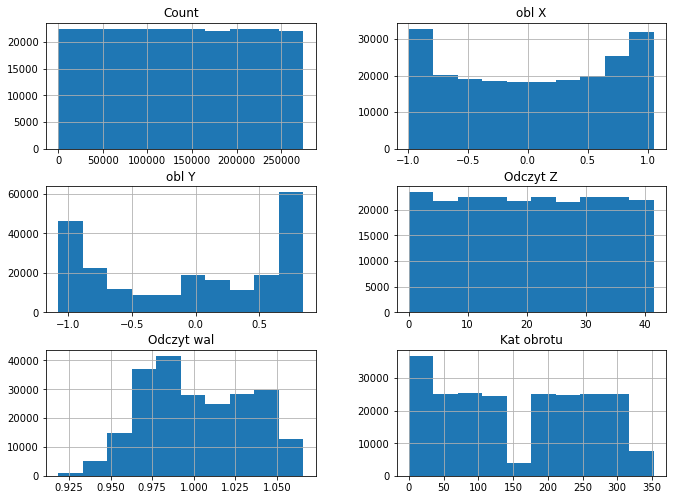

In [11]:
df.hist()

<AxesSubplot:>

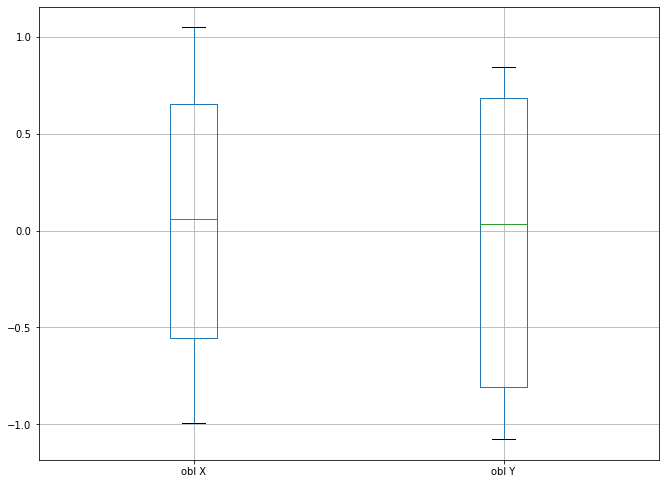

In [12]:
df.boxplot(column=['obl X', 'obl Y'])

Maximum angle value: 
352.62
Minimum angle value: 
0.0


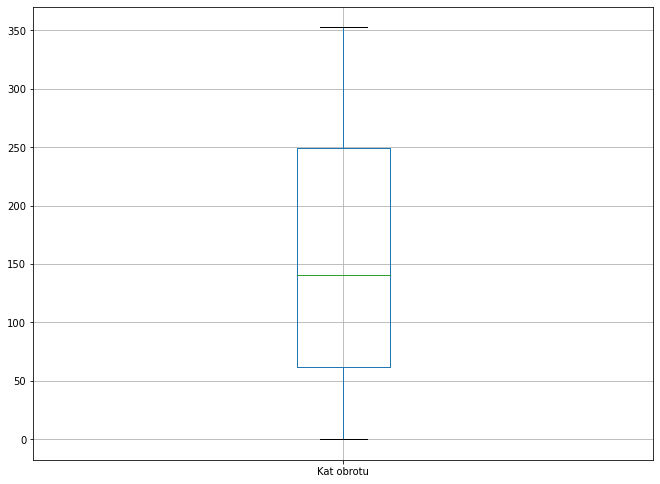

In [13]:
df.boxplot(column=['Kat obrotu'])
print('Maximum angle value: ')
print(df['Kat obrotu'].max())
print('Minimum angle value: ')
print(df['Kat obrotu'].min())

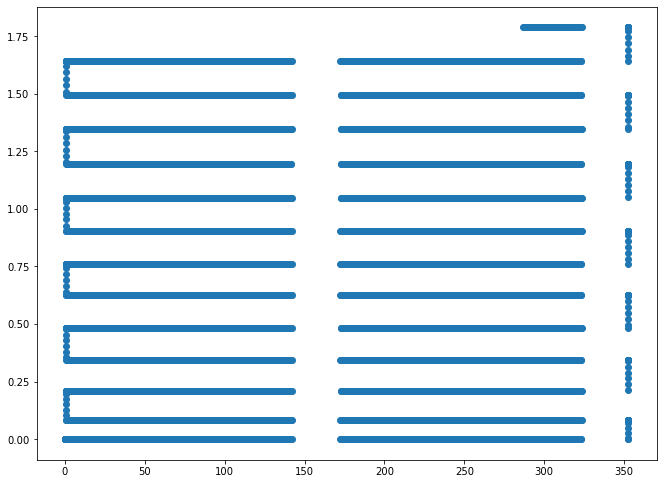

In [14]:

angles = angle[:10000]
zs = z[:10000]
cs = count[:2000]


plt.scatter(angles, zs)
plt.show()

## 3D plotting whole dataset

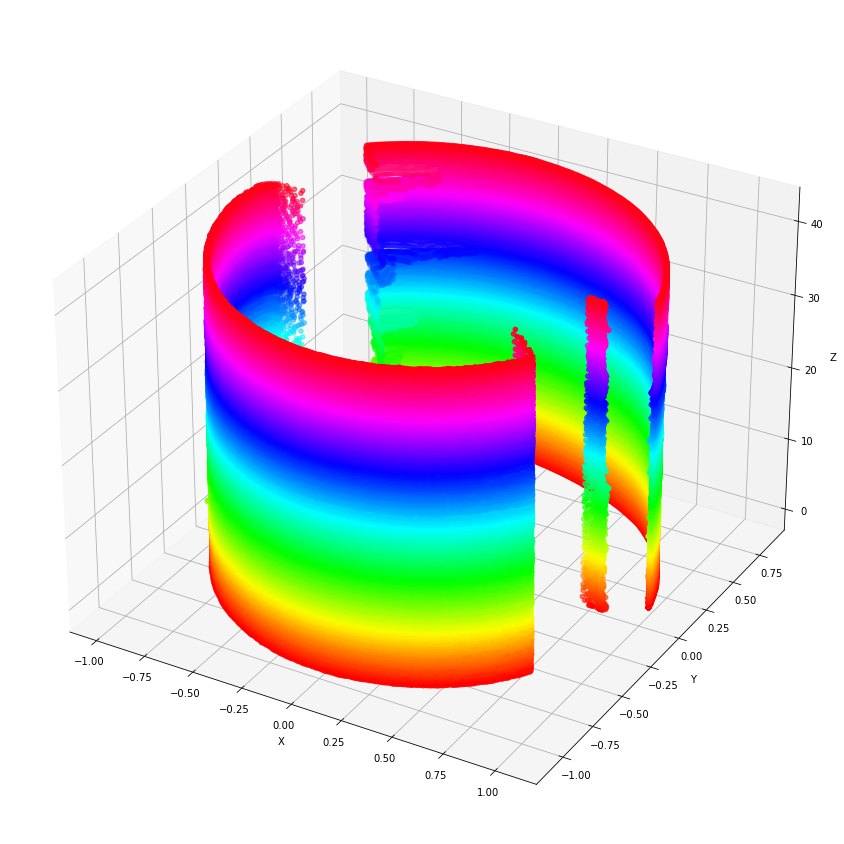

In [15]:
plt.figure(figsize=(1100*px, 1100*px))
ax = plt.axes(projection ='3d')

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.scatter3D(x, y, z, c=z, cmap='hsv')

plt.show()

## Reduce dataset through cutting outliers on Z-axis

In [16]:
# xs = x[1500: 90000]
# ys = y[1500: 90000]
# zs = z[1500: 90000]
xs = x
ys = y
zs = z

In [17]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Scatter3d(
    x=xs, 
    y=ys, 
    z=zs, 
    # mode='markers',
    marker=dict(
        size=2,
        color=z,  # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8,
    ),
)])

fig.update_layout(
    autosize=False,
    width=1000,
    height=1000,)
fig.show()

### Finding best fitting cylinder to data


In [23]:
from cylinder_fitting import fit

xx = xs.to_numpy()
yy = ys.to_numpy()
zz = zs.to_numpy()

points = np.array([xx,yy,zz]) 


points = np.transpose(points)

w_fit, C_fit, r_fit, fit_err = fit(points)

In [48]:
print("Center point: ", C_fit) 
print("Radius: ", r_fit) 
print("Vector: ", w_fit) 

Center point:  [ 1.81733179e-02 -1.09064926e-01  2.06728832e+01]
Radius:  0.9631398409675589
Vector:  [-5.42763479e-05  7.14854034e-04  9.99999743e-01]


## Calculating cylinder surface based on center, radius and vector

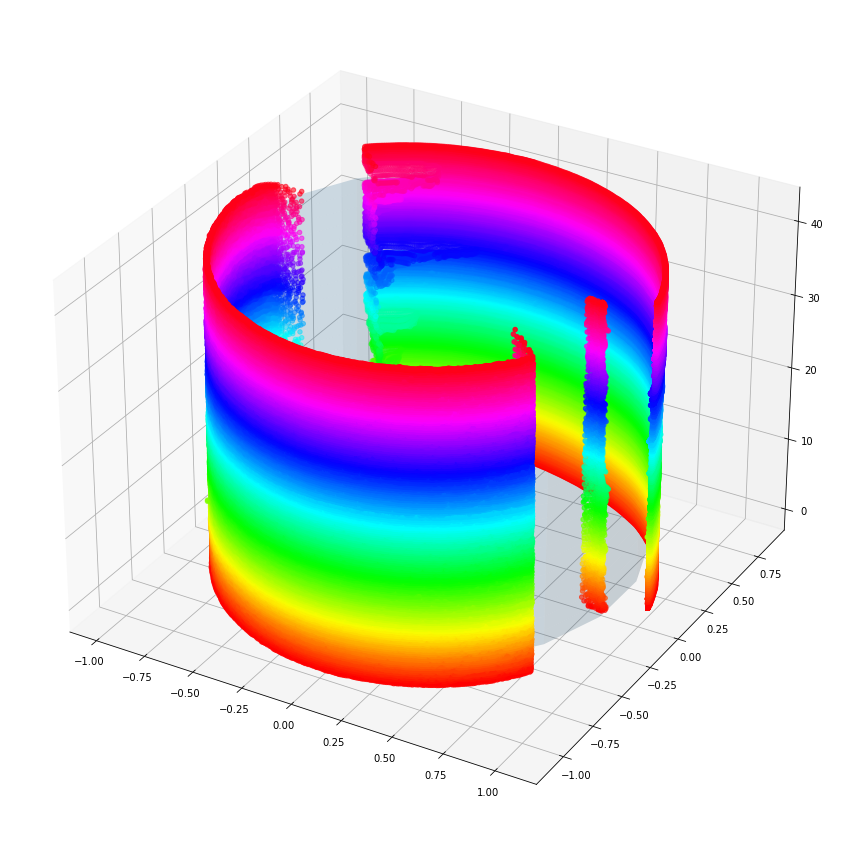

In [49]:
def rotation_matrix_from_axis_and_angle(u, theta):
    '''Calculate a rotation matrix from an axis and an angle.'''
    
    x = u[0]
    y = u[1]
    z = u[2]
    s = np.sin(theta)
    c = np.cos(theta)
    
    return np.array([[c + x**2 * (1 - c), x * y * (1 - c) - z * s, x * z * (1 - c) + y * s],
                     [y * x * (1 - c) + z * s, c + y**2 * (1 - c), y * z * (1 - c) - x * s ],
                     [z * x * (1 - c) - y * s, z * y * (1 - c) + x * s, c + z**2 * (1 - c) ]])

# Get the transformation matrix

theta = np.arccos(np.dot(w_fit, np.array([0, 0, 1])))
phi = np.arctan2(w_fit[1], w_fit[0])

M = np.dot(rotation_matrix_from_axis_and_angle(np.array([0, 0, 1]), phi),
               rotation_matrix_from_axis_and_angle(np.array([0, 1, 0]), theta))


   
delta = np.linspace(-np.pi, np.pi, 20)
z = np.linspace(-18, 18, 20)


Delta, Z = np.meshgrid(delta, z)
X = r_fit * np.cos(Delta)
Y = r_fit * np.sin(Delta)

for i in range(len(X)):
    for j in range(len(X[i])):
        p = np.dot(M, np.array([X[i][j], Y[i][j], Z[i][j]])) + C_fit

        X[i][j] = p[0]
        Y[i][j] = p[1]
        Z[i][j] = p[2]

# Plot the cylinder surface
%matplotlib inline
import matplotlib.pyplot as plt
plt.figure(figsize=(1100*px, 1100*px))
ax = plt.axes(projection ='3d')
ax.scatter3D(xs, ys, zs, c=zs, cmap='hsv')

ax.plot_surface(X, Y, Z, alpha=0.2)

plt.show()

## Vizualization of cylinder and measurment points

In [50]:
scPoints=go.Scatter3d(
    x=xs, 
    y=ys, 
    z=zs, 
    # mode='markers',
    marker=dict(
        size=2,
        color=z,  # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8,
    ),
)

cyl2 = go.Surface(x=X, y=Y, z=Z,
                 showscale=False,
                 opacity=0.7)

fig =  go.Figure(data=[cyl2, scPoints])

fig.update_layout(
    autosize=False,
    width=1000,
    height=1000,)

fig.show()
fig.write_html('graph.html')


# import dash
# import dash_core_components as dcc
# import dash_html_components as html

# app = dash.Dash()
# app.layout = html.Div([
#     dcc.Graph(figure=fig)
# ])

# app.run_server(debug=True, use_reloader=False)  # Turn off reloader if inside Jupyter